<a href="https://colab.research.google.com/github/JRafaQuadros91/manfing-test/blob/main/dados/testeManfing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Teste Data Science Manfing - João Rafael Quadros



*   ###  Preparação, Limpeza e Transformação dos dados.
*   ###  Análise do Dataset, definição de objetivos e escolha/aplicação de modelo de Machine Learning.

---




> ### Neste notebook estarei tratando a base de dados "DataSet_Test" que foram disponibilizados via e-mail.




# Storytelling e anotações sobre o processo.

### 1 - Primeiramente foi realizada a Import das bibliotecas, configurado o ambiente e a importação do Dataset.

### 2 - Aqui realizamos uma análise descritiva desses dados, nesse ponto foi decidido por alterar o headers do Dataset para uma melhor visualização e entendimento durante o processo. Nessa etapa também foi verificado que existiam valores distoantes nas colunas Quantidade e Preço, será necessário resolver essa questão.


### 3 - Tratamento dos valores negativos para Quantidade e Preço e suposição do Dataset ser de um e-commerce bem variado em vários paises.

### 4 - Definido a estratégia de tratamento dos dados, dropar os dados nulos e negativos.

### 5 - Dados tratados e conferidos, passaremos a analisar os dados, suas variáveis , a dependência entre elas e definir planejamento, algumas métricas para visualização e modelos de Machine Learning aplicáveis.

### 6 - Após métricas e suas visualizações, será definido a abordagem e o/os algoritmos de machine learning aplicáveis para uma melhor análise e possível predição.


### 7 - Verificada a possibilidade de utilizar aprendizado supervisionado, escolhido os algoritmos de regressão linear e random forest, após comparações entre modelos e aplicação de machine learning, essa hipótese se tornou descartável, o modelo ficou underfiting, a correlação entre as variáveis do sub-dataset era irrelevante para que existisse uma correlação entre elas a ser utilizada para predições do algoritmo

### 8 - Seguiremos para a próxima ideia, Clustering, utilizaremos um modelo de associação.

### 9 - Dentre os metodos de k-means e apriori, o que chamou mais atenção foi o segundo , que teve uma boa confiança de associação de produtos em alguns deles (> 70%) o que poderia levar a estratégias da rede que vende os itens a elaborar promoções com esses itens, ou trabalhar com indicações de itens para associar com desconto.



# Considerações.

### Quanto ao tratamento dos dados, dataset não tinha muitos problemas, além de alguns produtos com descrição do tipo '???lost', mas eram pouquissimos casos, além de alguns dados duplicados, e com valores nulos, a opção foi dropar esses dados ao invez de substituir por alguma métrica como média, moda ou mediana

### Seria possível metrificar e prever valores totais agrupando por clientes, seja criando grupos com intervalos classificando tipos de compradores, ou a relação dos clientes com o passar do tempo. Para isso seria necessário alterar os dados e agrupá-los e então tratar essas abordagens, assim , seria utilizado algum método de predição utilizando algoritmos de regressão.

### Contudo , a abordagem foi utilizar o Dataset mais "naturalmente" com os dados da maneira que foram disponibilizados e trazer uma utilizade para eles, como se trata de alguma rede de supermercados ou coisa do tipo, acredito válida uma abordagem de associação, assim, poderiam se pensar várias estratégias para aumentar o lucro desde promoções envolvendo itens associados e indicações de itens que tem associação para adicionar ao carrinho de compras.

# Bibliotecas


In [ ]:
# Imports
import pandas as pd
import numpy as np
import pathlib 
import os
import seaborn as sns
import matplotlib.pyplot  as plt
import plotly.express as px
import statsmodels.api    as sm

from sklearn.model_selection import train_test_split 
from sklearn import tree
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing    import MinMaxScaler , StandardScaler
from sklearn.linear_model     import LinearRegression 
from sklearn.model_selection  import cross_val_score
from sklearn.metrics          import r2_score
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import KMeans
from mlxtend.frequent_patterns import apriori, association_rules




/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


#Configucações do ambiente

In [ ]:
#Configs 
pd.set_option('display.max_rows' , None) # Configurando pandas para não delimitar apresentação de linhas ou colunas
pd.set_option('display.max_columns' , None)

# Configurando pandas para não mostrar notação cientifica para números:

pd.set_option('display.float_format' , lambda x: '%.2f' % x)

# Importação do Dataset

In [ ]:
!git clone https://github.com/JRafaQuadros91/manfing-test.git

Cloning into 'manfing-test'...
remote: Enumerating objects: 14, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 14 (delta 3), reused 7 (delta 1), pack-reused 0
Unpacking objects: 100% (14/14), done.


In [ ]:
#Importando Dataset
df = pd.read_excel("/content/manfing-test/data/DataSet_Test.xlsx")

# Descrição dos dados

In [ ]:
# Verificando quantidade de linhas e colunas
print('Linhas: ', df.shape[0])
print('Colunas: ' , df.shape[1])

Linhas:  522064
Colunas:  7


In [ ]:
# Verificando quantidade de linhas e colunas - forma 2 
total_row=len(df.index)
total_col=df.shape[1]
print(total_row,total_col)

522064 7


In [ ]:
df.head()

,BillNo,Itemname,Quantity,Date,Price,CustomerID,Country
0,536365,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.00,United Kingdom
1,536365,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom
2,536365,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.00,United Kingdom
3,536365,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom
4,536365,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom


In [ ]:
# Alterando Headers - não é obrigatório , apenas para deixar mais fácil a leitura
df.columns = ['Pedido','Produto','Quantidade','Data','Preco','Id_Cliente','Pais']

In [ ]:
df.dtypes

Pedido                object
Produto               object
Quantidade             int64
Data          datetime64[ns]
Preco                float64
Id_Cliente           float64
Pais                  object
dtype: object

# Estatísticas Descritivas

In [ ]:
df.describe() 

,Quantidade,Preco,Id_Cliente
count,522064.00,522064.00,388023.00
mean,10.09,3.83,15316.93
std,161.11,41.90,1721.85
min,-9600.00,-11062.06,12346.00
25%,1.00,1.25,13950.00
50%,3.00,2.08,15265.00
75%,10.00,4.13,16837.00
max,80995.00,13541.33,18287.00


# Verificado que os campos Quantidade e Preco possuem valores negativos, que deverão ser tratados posteriormente.


In [ ]:
df['Pais'].value_counts().sort_values(ascending=True) # verificando a distribuição dos paises e a quantidade de registros de cada um.
# df['Pais'].value_counts().sort_values(ascending=False) # mesma situação que a distribuição acima, porém, do maior para o menor.

Saudi Arabia                 9
Bahrain                     18
Brazil                      32
Lithuania                   35
Lebanon                     45
RSA                         58
United Arab Emirates        68
Malta                      112
Greece                     145
USA                        179
Iceland                    182
Singapore                  222
Hong Kong                  284
Israel                     295
Japan                      321
Poland                     330
Austria                    398
Unspecified                446
Sweden                     451
Italy                      758
Norway                    1072
Australia                 1185
Portugal                  1501
Switzerland               1967
Belgium                   2031
Netherlands               2363
Spain                     2485
France                    8408
Germany                   9042
United Kingdom          487622
Name: Pais, dtype: int64

In [ ]:
df['Produto'].value_counts().sort_values(ascending=True) # verificando a distribuição dos paises e a quantidade de registros de cada um.
# df['Produto'].value_counts().sort_values(ascending=False) # mesma situação que a distribuição acima, porém, do maior para o menor.

PAPER CRAFT , LITTLE BIRDIE                1
PINK CHERRY LIGHTS                         1
mouldy, thrown away.                       1
PINK DOLLY HAIR CLIPS                      1
RED PURSE WITH PINK HEART                  1
LARGE ROUND CUTGLASS CANDLESTICK           1
CAMOUFLAGE DOG COLLAR                      1
PINK CHRYSANTHEMUMS ART FLOWER             1
HEAVENS SCENT FRAGRANCE OILS ASSTD         1
BLUE DROP EARRINGS W BEAD CLUSTER          1
PURPLE ANEMONE ARTIFICIAL FLOWER           1
BIG POLKADOT MUG                           1
barcode problem                            1
wrong barcode                              1
PINK SMALL GLASS CAKE STAND                1
RUBY GLASS NECKLACE 42"                    1
BLUE CRYSTAL BOOT PHONE CHARM              1
WIRE FLOWER T-LIGHT HOLDER                 1
GLASS CAKE COVER AND PLATE                 1
ROSE PENDANT TRIPLE SHELL NECKLACE         1
SCALLOP SHELL SOAP DISH                    1
BLUE/NAT SHELL NECKLACE W PENDANT          1
incorrectl

In [ ]:
df['Pedido'].value_counts().sort_values(ascending=True) # verificando a distribuição dos paises e a quantidade de registros de cada um.
# df['Produto'].value_counts().sort_values(ascending=False) # mesma situação que a distribuição acima, porém, do maior para o menor.

561895        1
538130        1
538131        1
538132        1
538133        1
538134        1
538135        1
538136        1
538137        1
538138        1
538139        1
548913        1
567863        1
550762        1
538141        1
538142        1
550450        1
549008        1
556097        1
558653        1
558663        1
579460        1
550671        1
549107        1
556200        1
538140        1
538129        1
538128        1
567862        1
538175        1
538179        1
556012        1
548897        1
538188        1
548890        1
548889        1
538192        1
538193        1
538194        1
578847        1
578845        1
538144        1
558912        1
538143        1
558921        1
579015        1
558914        1
558915        1
558917        1
548940        1
579009        1
565678        1
579006        1
567861        1
537863        1
565760        1
558697        1
579452        1
579511        1
550660        1
558624        1
556242        1
537833  

In [ ]:
df['Quantidade'].value_counts().sort_values(ascending=True) # verificando a distribuição dos paises e a quantidade de registros de cada um.
# df['Pais'].value_counts().sort_values(ascending=False) # mesma situação que a distribuição acima, porém, do maior para o menor.

 80995         1
-2003          1
-2618          1
-1671          1
 77            1
-657           1
-900           1
 148           1
 177           1
-905           1
 1992          1
 912           1
-1000          1
 4800          1
 490           1
-335           1
-674           1
 388           1
-164           1
 760           1
-864           1
 249           1
-152           1
 688           1
 326           1
-280           1
 1130          1
 199           1
 207           1
 404           1
-313           1
 750           1
 279           1
-398           1
-175           1
-184           1
-327           1
-103           1
-1128          1
-1158          1
 122           1
-434           1
-83            1
-450           1
-323           1
 2160          1
-259           1
-5368          1
-1100          1
-1277          1
-541           1
-1121          1
-1200          1
-975           1
 992           1
-4830          1
 630           1
-135           1
-98           

In [ ]:
df['Data'].value_counts().sort_values(ascending=True) # verificando a distribuição dos paises e a quantidade de registros de cada um.
# df['Pais'].value_counts().sort_values(ascending=False) # mesma situação que a distribuição acima, porém, do maior para o menor.

2011-07-01 14:50:00       1
2011-03-29 10:27:00       1
2011-03-29 10:52:00       1
2011-10-07 13:57:00       1
2011-10-07 13:40:00       1
2011-10-07 13:11:00       1
2011-10-07 12:45:00       1
2011-03-29 12:10:00       1
2011-05-04 14:54:00       1
2011-03-29 12:18:00       1
2011-03-29 12:20:00       1
2011-03-24 13:57:00       1
2011-10-14 10:48:00       1
2011-10-11 11:47:00       1
2011-10-11 12:00:00       1
2011-09-06 15:53:00       1
2011-03-29 10:26:00       1
2011-03-29 10:23:00       1
2011-05-05 08:30:00       1
2011-10-07 14:56:00       1
2011-05-03 16:51:00       1
2011-10-07 10:09:00       1
2011-03-29 12:36:00       1
2011-10-07 12:27:00       1
2011-10-07 12:29:00       1
2011-03-28 15:16:00       1
2011-03-28 15:19:00       1
2011-10-13 13:20:00       1
2011-10-07 16:21:00       1
2011-03-28 16:28:00       1
2011-10-07 15:50:00       1
2011-10-07 15:32:00       1
2011-03-29 09:36:00       1
2011-03-29 09:54:00       1
2011-03-29 10:18:00       1
2011-03-29 10:20:00 

In [ ]:
df['Preco'].value_counts().sort_values(ascending=True) # verificando a distribuição dos paises e a quantidade de registros de cada um.
# df['Pais'].value_counts().sort_values(ascending=False) # mesma situação que a distribuição acima, porém, do maior para o menor.

307.17           1
144.45           1
214.42           1
403.81           1
171.04           1
307.85           1
334.16           1
29.43            1
105.71           1
470.12           1
111.86           1
86.77            1
108.75           1
4.79             1
127.24           1
168.19           1
198.21           1
157.76           1
248.48           1
127.09           1
80.46            1
285.30           1
149.49           1
138.50           1
192.21           1
188.88           1
230.61           1
223.89           1
161.08           1
200.33           1
246.37           1
200.38           1
247.54           1
216.11           1
150.25           1
124.16           1
163.67           1
100.00           1
172.62           1
208.92           1
254.08           1
117.42           1
211.80           1
211.86           1
1569.04          1
33.05            1
194.70           1
203.73           1
84.21            1
4.17             1
191.46           1
213.71           1
3.13        

In [ ]:
df['Id_Cliente'].value_counts().sort_values(ascending=True) # verificando a distribuição dos paises e a quantidade de registros de cada um.
# df['Pais'].value_counts().sort_values(ascending=False) # mesma situação que a distribuição acima, porém, do maior para o menor.

15940.00       1
15524.00       1
13135.00       1
15195.00       1
17986.00       1
16737.00       1
17752.00       1
15562.00       1
14351.00       1
13120.00       1
15823.00       1
13391.00       1
16765.00       1
17925.00       1
17347.00       1
16323.00       1
15070.00       1
13747.00       1
16144.00       1
18068.00       1
15389.00       1
18174.00       1
13017.00       1
14705.00       1
13302.00       1
16953.00       1
18113.00       1
17715.00       1
16078.00       1
17923.00       1
15657.00       1
16881.00       1
14576.00       1
13366.00       1
13256.00       1
16742.00       1
17331.00       1
16093.00       1
15510.00       1
16073.00       1
16738.00       1
13841.00       1
15316.00       1
17948.00       1
15802.00       1
15753.00       1
18233.00       1
12346.00       1
18268.00       1
17846.00       1
13270.00       1
13185.00       1
17956.00       1
15118.00       1
17291.00       1
13106.00       1
17763.00       1
18133.00       1
13703.00      

# Após uma listagem dos valores, verificado que os maiores problemas do Dataset são os valores negativos em Preco e Quantidade. Além disso , pela diversidade de tipos de Produtos, dataset pode ser uma listagem de compras
# com quantidades e valores dos produtos de uma loja de conveniência, supermercado , ou algo similar.


#Tratamento dos dados

In [ ]:
# verificando a existencia de campos nulos.
df.isnull().sum() # existem campos em id_cliente e produto.

Pedido             0
Produto         1455
Quantidade         0
Data               0
Preco              0
Id_Cliente    134041
Pais               0
dtype: int64

In [ ]:
# verificando se existem linhas duplicadas

df.duplicated().sum() # existem 5286

5286

In [ ]:
df.duplicated()

0         False
1         False
2         False
3         False
4         False
5         False
6         False
7         False
8         False
9         False
10        False
11        False
12        False
13        False
14        False
15        False
16        False
17        False
18        False
19        False
20        False
21        False
22        False
23        False
24        False
25        False
26        False
27        False
28        False
29        False
30        False
31        False
32        False
33        False
34        False
35        False
36        False
37        False
38        False
39        False
40        False
41        False
42        False
43        False
44        False
45        False
46        False
47        False
48        False
49        False
50        False
51        False
52        False
53        False
54        False
55        False
56        False
57        False
58        False
59        False
60        False
61        False
62      

In [ ]:
# Verificando se existem linhas NaN

df.isna().sum() # são as mesmas encontradas com "df.isnull()"

Pedido             0
Produto         1455
Quantidade         0
Data               0
Preco              0
Id_Cliente    134041
Pais               0
dtype: int64

# Após verificar os campos ,NaN, nulos, e duplicados, iremos tratar esses casos.

# Analisando que os campos que possuem dados faltantes ou invalidos são "Produto e id_cliente" e os campos com valores negativos são "Preco e Quantidade", poderiamos adotar algumas estratégias para solução desse problema. Tal quais fazer um replace da quantidade e preco dos valores negativos pela média ou mediana dos valores totais referente a cada coluna. Também para os campos Produto e Id_cliente subistituir pela moda os valores nulos ou invalidos.

# Contudo, analisando o Dataframe acredito que a melhor estratéria seria dropar esses campos.

In [ ]:
# Dropar valores NaN
df.dropna(inplace=True)
# Dropando valores negativos para quantidade
df = df[df["Quantidade"] > 0]


In [ ]:
# Na coluna preco, iremos transformar os valores para numéricos e então sim, dropar os negativos.
df = df[df["Preco"] > 0]

In [ ]:
# Dropando duplicados

df=df.drop_duplicates()

In [ ]:
# verificando como ficaram os dados após os tratamentos.

def validar_df(df, head=5):
    print("##################### Shape #####################")
    print(df.shape)

    print("##################### Dtype #####################")
    print(df.dtypes)

    print("##################### Head #####################")
    print(df.head(head))

    print("##################### Tail #####################")
    print(df.tail(head))

    print("##################### NaN #####################")
    print(df.isnull().sum())

    print("##################### Duplicados #####################")
    print(df.duplicated().sum())

validar_df(df)

##################### Shape #####################
(382773, 7)
##################### Dtype #####################
Pedido                object
Produto               object
Quantidade             int64
Data          datetime64[ns]
Preco                float64
Id_Cliente           float64
Pais                  object
dtype: object
##################### Head #####################
   Pedido                              Produto  Quantidade  \
0  536365   WHITE HANGING HEART T-LIGHT HOLDER           6   
1  536365                  WHITE METAL LANTERN           6   
2  536365       CREAM CUPID HEARTS COAT HANGER           8   
3  536365  KNITTED UNION FLAG HOT WATER BOTTLE           6   
4  536365       RED WOOLLY HOTTIE WHITE HEART.           6   

                 Data  Preco  Id_Cliente            Pais  
0 2010-12-01 08:26:00   2.55    17850.00  United Kingdom  
1 2010-12-01 08:26:00   3.39    17850.00  United Kingdom  
2 2010-12-01 08:26:00   2.75    17850.00  United Kingdom  
3 2010-12-01 

# Campos negativos e invalidos removidos do Dataset, agora passaremos para a Visualização de algumas métricas possíveis.

In [ ]:
# Total de vendas por Cliente

total_vendas = df 
total_vendas["Preco_Total"] = total_vendas["Preco"] * total_vendas["Quantidade"] #Criando coluna a partir da multiplicacao entre preco e quantidade
total_vendas_cliente = total_vendas.groupby(["Id_Cliente", "Pais"]).agg({"Preco_Total": "sum"}) # Usando essa coluna criada para visualizar a soma desses precos totalizados agrupados por id_cliente e Pais.
total_vendas_cliente.head(25)

,,Preco_Total
Id_Cliente,Pais,
12346.00,United Kingdom,77183.60
12347.00,Iceland,4310.00
12349.00,Italy,1757.55
12350.00,Norway,334.40
12352.00,Norway,2506.04
12353.00,Bahrain,89.00
12354.00,Spain,1079.40
12355.00,Bahrain,459.40
12356.00,Portugal,2811.43


In [ ]:
# top 10 clientes
total_vendas_cliente.reset_index(inplace=True)
total_vendas_cliente.sort_values(by = "Preco_Total", ascending = False).head(10) # a partir do dataframe e sua visualização criada anteriormente , é possivel organizar os valores de forma descendente 
                                                                                 # visualizar os 10 maiores valores

,Id_Cliente,Pais,Preco_Total
1663,14646.00,Netherlands,280206.02
4162,18102.00,United Kingdom,259657.30
3690,17450.00,United Kingdom,194390.79
2972,16446.00,United Kingdom,168472.50
44,12415.00,Australia,124914.53
3733,17511.00,United Kingdom,91062.38
2666,16029.00,United Kingdom,80850.84
0,12346.00,United Kingdom,77183.60
3140,16684.00,United Kingdom,66653.56
1266,14096.00,United Kingdom,65164.79


<Figure size 432x288 with 0 Axes>

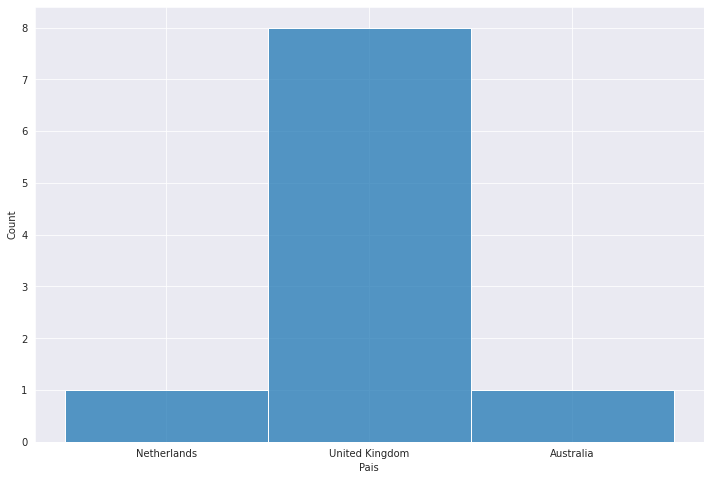

In [ ]:
#Plotando essa distribuição

top10 = total_vendas_cliente.sort_values(by = "Preco_Total", ascending = False).head(10)

sns.set_style( "darkgrid" )

plt.tight_layout()

fig = plt.figure( figsize = ( 12 , 8 ) )

sns.histplot( data = top10 , x = 'Pais');

plt.show();

#Insight -  Verificado que 80% das 10 maiores vendas estão no Reino Unido.

In [ ]:
# Total de vendas agrupados por pais
total_vendas_cliente.groupby(["Pais"]).agg({"Preco_Total":"sum"}).reset_index().sort_values(by="Preco_Total", ascending=False )

,Pais,Preco_Total
27,United Kingdom,7284789.39
15,Netherlands,285446.34
6,Germany,228678.40
5,France,208934.31
0,Australia,138453.81
22,Spain,61558.56
24,Switzerland,56443.95
3,Belgium,41196.34
23,Sweden,38367.83
11,Japan,37416.37


In [ ]:
# consider that for all time period
total_vendas_cliente_plot = total_vendas_cliente.groupby(["Pais"]).agg({"Preco_Total":"sum"}).reset_index().sort_values(by="Preco_Total", ascending=False )
plot2 = px.bar(total_vendas_cliente_plot, x='Pais', y='Preco_Total' , title = "Distribuição de vendas por Pais")
plot2.show()


In [ ]:
# Plotando uma distribuicao das 50 maiores vendas e seus paises , também coloquei uma "trendline" pra verificarmos padrões e "outliers" em relação a essa distribuição.
total_vendas_plot2 = total_vendas_cliente.sort_values(by = "Preco_Total", ascending = False).head(50)

plot = px.scatter(total_vendas_plot2, x="Id_Cliente", y="Preco_Total",
	         size="Preco_Total", color="Pais",
                 hover_name="Pais", log_x=True, size_max=60, title="Top 50 Clientes",range_x=None,trendline="ols", trendline_scope="overall",trendline_color_override="purple")
plot.show()

# Possivel ver que as vendas tendem a seguir um padrão próximo a trendline , com exceção de alguns pontos, como o cliente de "Netherlands" que está bem acima do padrão.

# Pontos a serem análizados sobre o Dataset.

### 1 - Dataset que relaciona pedidos, produções, quantidades e preço unitário.

### 2 - Esse dataset não possui um valor total de vendas, ou alguma variável fortemente dependente, o valor unitario dos produtos podem mudar sem afetar os demais campos, bem como a quantidade, ou os demais campos.

### 3 - Tendo isso em vista, acredito a melhor abordagem seria as seguintes hipoteses : Criar um sub-dataset com valor total de vendas , agrupando por pais e cliente (relação já realizada para definição de métricas para geração de insights) e a partir disso, criar uma depêndencia entre essas variaveis e trabalhar em uma hipotese de predição usando aprendizado supervisionado - regressão, para podermos predizer o valor total de vendas previsto de acordo com determinado pais, etc. Contudo não trabalhariamos com o Dataset "in natura" kk. A outra ideia seria trabalhar com a hipotese de aprendizado não supervisionado, com um algoritmo de clusterização (agrupamento ou associação), nesse caso, poderia utilizar a abordagem de associação.

<Figure size 432x288 with 0 Axes>

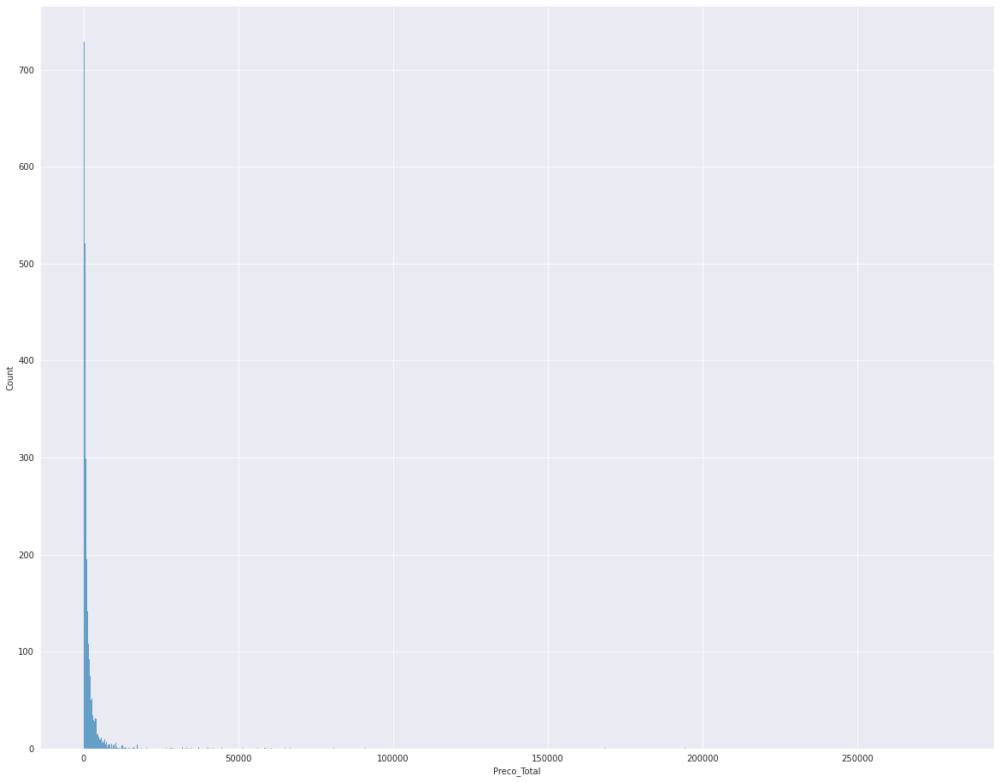

In [ ]:
# Hipotese 1 - sub-dataset

# Definindo e analisando a variável alvo: Preco_Total

sns.set_style( "darkgrid" )

plt.tight_layout()

fig = plt.figure( figsize = (20 , 16 ) )

sns.histplot( data = total_vendas_cliente , x = 'Preco_Total');

plt.show();

<Figure size 432x288 with 0 Axes>

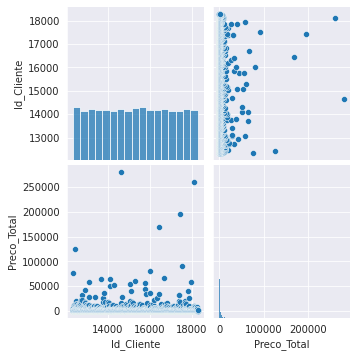

In [ ]:
# Relação entre variáveis e alvo

sns.set_style( "darkgrid" )

plt.tight_layout()

sns.pairplot(data=total_vendas_cliente)

plt.show();

# Modelos de machine learning a serem testados nessa hipotese : Decision Tree, Random Forest, Linear Regression.

In [ ]:
## Definindo Variaveis



# Variáveis
alvo = 'Preco_Total' #variável alvo
target = total_vendas_cliente[alvo] #Separa a variável alvo


#Variaveis Dummy
baseFiltroquali = ['Id_Cliente', 'Pais',] #Variáveis qualitativas
dfQuali = pd.get_dummies(total_vendas_cliente[baseFiltroquali])

#baseFiltroquant = [] #Variáveis quantitativas
#dfQuant = total_vendas_cliente[baseFiltroquant] #Dataframe com quantitativas
#dfWork = pd.concat([dfQuali, dfQuant], axis=1) #Dataframe com todas variáveis

# Sem variaveis quantitativas além da target
dfWork = dfQuali


In [ ]:
# Separando Dataset em treino e teste
dfWork_train, dfWork_test, target_train, target_test = train_test_split(dfWork, target, train_size=0.7, random_state=42)
print('O dataset de treino possui {} Registros e o de teste {} Registros.'.format(dfWork_train.shape[0], dfWork_test.shape[0]))

O dataset de treino possui 3009 Registros e o de teste 1290 Registros.


In [ ]:
scaler = MinMaxScaler()

In [ ]:
colunas = dfWork_train.columns

dfWork_train[colunas] = scaler.fit_transform(dfWork_train)
dfWork_test[colunas] = scaler.transform(dfWork_test)

dfWork_train.shape , dfWork_test.shape

((3009, 30), (1290, 30))

In [ ]:
dfWork_train.describe()

,Id_Cliente,Pais_Australia,Pais_Austria,Pais_Bahrain,Pais_Belgium,Pais_Brazil,Pais_France,Pais_Germany,Pais_Greece,Pais_Iceland,Pais_Israel,Pais_Italy,Pais_Japan,Pais_Lebanon,Pais_Lithuania,Pais_Malta,Pais_Netherlands,Pais_Norway,Pais_Poland,Pais_Portugal,Pais_RSA,Pais_Saudi Arabia,Pais_Singapore,Pais_Spain,Pais_Sweden,Pais_Switzerland,Pais_USA,Pais_United Arab Emirates,Pais_United Kingdom,Pais_Unspecified
count,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00,3009.00
mean,0.50,0.00,0.00,0.00,0.01,0.00,0.02,0.02,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.01,0.00,0.00,0.92,0.00
std,0.29,0.04,0.05,0.03,0.07,0.00,0.13,0.15,0.03,0.02,0.03,0.05,0.04,0.02,0.02,0.03,0.04,0.05,0.04,0.06,0.00,0.02,0.00,0.08,0.04,0.07,0.02,0.03,0.28,0.03
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.25,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
50%,0.51,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
75%,0.75,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
max,1.00,1.00,1.00,1.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00


In [ ]:
dfWork_test.describe()

,Id_Cliente,Pais_Australia,Pais_Austria,Pais_Bahrain,Pais_Belgium,Pais_Brazil,Pais_France,Pais_Germany,Pais_Greece,Pais_Iceland,Pais_Israel,Pais_Italy,Pais_Japan,Pais_Lebanon,Pais_Lithuania,Pais_Malta,Pais_Netherlands,Pais_Norway,Pais_Poland,Pais_Portugal,Pais_RSA,Pais_Saudi Arabia,Pais_Singapore,Pais_Spain,Pais_Sweden,Pais_Switzerland,Pais_USA,Pais_United Arab Emirates,Pais_United Kingdom,Pais_Unspecified
count,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00,1290.00
mean,0.49,0.00,0.00,0.00,0.01,0.00,0.03,0.02,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.00,0.01,0.00,0.00,0.00,0.00,0.90,0.00
std,0.29,0.06,0.06,0.00,0.08,0.03,0.16,0.15,0.04,0.00,0.03,0.06,0.04,0.00,0.00,0.00,0.05,0.04,0.03,0.07,0.03,0.00,0.03,0.10,0.04,0.06,0.05,0.00,0.30,0.03
min,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.24,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
50%,0.48,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
75%,0.75,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
max,1.00,1.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00,0.00,1.00,1.00,1.00,0.00,0.00,0.00,1.00,1.00,1.00,1.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00,0.00,1.00,1.00


# Após definição das variaveis , do target, da separação do dataset em treino e teste, iremos ver a correlação entre as variáveis.

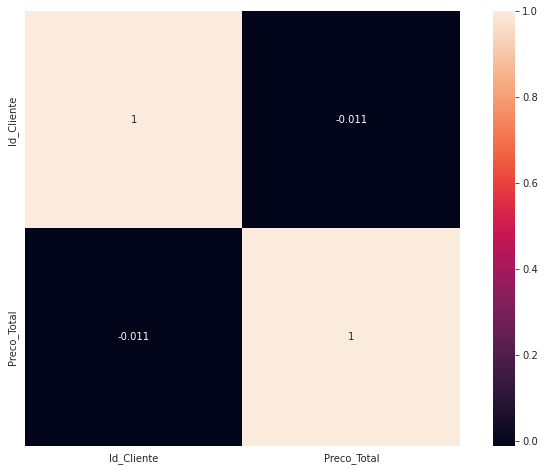

In [ ]:
# Correlação

figura1 , graficos1 = plt.subplots( figsize = ( 12 , 8 ) )

corr = total_vendas_cliente.corr()

sns.heatmap( corr , mask = np.zeros_like( corr, dtype = bool ) ,
             square = True , ax = graficos1 , annot = True);

In [ ]:
# Implementando Regressão Linear

regressao_linear = LinearRegression()

valores_rmse_rl = cross_val_score(estimator=regressao_linear,
                                  X=dfWork_train,
                                  y=target_train,
                                  cv=10,
                                  scoring='neg_root_mean_squared_error')
valores_rmse_rl

array([-2.78343609e+03, -6.01035393e+14, -3.14491866e+12, -7.44351796e+14,
       -8.29023179e+03, -1.54877655e+04, -8.83521184e+14, -3.11758461e+03,
       -7.16731805e+03, -1.63483259e+04])

In [ ]:
valores_rmse_rl = valores_rmse_rl * -1
valores_rmse_rl

array([2.78343609e+03, 6.01035393e+14, 3.14491866e+12, 7.44351796e+14,
       8.29023179e+03, 1.54877655e+04, 8.83521184e+14, 3.11758461e+03,
       7.16731805e+03, 1.63483259e+04])

In [ ]:
rmse_rl_media = valores_rmse_rl.mean()
rmse_rl_media

223205329158206.2

In [ ]:
rfr_regressao = RandomForestRegressor()

valores_rfr = cross_val_score(estimator=rfr_regressao,
                                      X=dfWork_train,
                                      y=target_train,
                                      cv=10,
                                      scoring='neg_root_mean_squared_error')
valores_rfr

array([ -3368.67569346,  -4460.48589729,  -4704.29950939,  -8455.13841508,
        -7549.33711835, -15403.19259907, -11880.45277109,  -4906.9200927 ,
       -14507.51380609, -16563.57269112])

In [ ]:
rfr_regressao.fit(dfWork_train, target_train)

RandomForestRegressor()

In [ ]:
for feature,importancia in zip(dfWork.columns,rfr_regressao.feature_importances_):
    print("{}:{} %".format(feature, (importancia)*100))

Id_Cliente:92.2668350225803 %
Pais_Australia:0.0011405380220192408 %
Pais_Austria:0.0011022057119994988 %
Pais_Bahrain:0.0015574336492341421 %
Pais_Belgium:0.004387112168531182 %
Pais_Brazil:0.0 %
Pais_France:0.017537488189096288 %
Pais_Germany:0.042819237709763334 %
Pais_Greece:0.00010971998304974503 %
Pais_Iceland:0.001465119212715168 %
Pais_Israel:0.007215888182533839 %
Pais_Italy:0.0011958569639073477 %
Pais_Japan:0.11912548573808689 %
Pais_Lebanon:0.0002024157866325293 %
Pais_Lithuania:0.00019739539804103116 %
Pais_Malta:0.0003851882414054139 %
Pais_Netherlands:6.859388937663804 %
Pais_Norway:0.015708240960188642 %
Pais_Poland:0.0025079116977512594 %
Pais_Portugal:0.0015463880813938382 %
Pais_RSA:0.0 %
Pais_Saudi Arabia:6.329774757907154e-05 %
Pais_Singapore:0.0 %
Pais_Spain:0.007096177271539773 %
Pais_Sweden:0.29962779568102854 %
Pais_Switzerland:0.03196812779890294 %
Pais_USA:0.00011228873001327472 %
Pais_United Arab Emirates:0.00020951557508715969 %
Pais_United Kingdom:0.316284

In [ ]:
valores_rfr_media = valores_rfr.mean() * -1

In [ ]:
valores_rfr_media

9179.958859364298

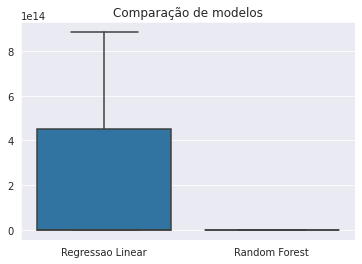

In [ ]:
comparar = pd.DataFrame({'Regressao Linear': valores_rmse_rl, 'Random Forest' : valores_rfr})

sns.boxplot( data = comparar).set_title('Comparação de modelos');

# Modelos comparados , escolheremos regressão linear


In [ ]:
# Análise com Regressão Linear

regressao_linear.fit(dfWork_train, target_train)

LinearRegression()

In [ ]:
regressao_linear.coef_

array([ 8.98970518e+02, -1.44884745e+14, -1.44884745e+14, -1.44884745e+14,
       -1.44884745e+14,  1.73320784e+14, -1.44884745e+14, -1.44884745e+14,
       -1.44884745e+14, -1.44884745e+14, -1.44884745e+14, -1.44884745e+14,
       -1.44884745e+14, -1.44884745e+14, -1.44884745e+14, -1.44884745e+14,
       -1.44884745e+14, -1.44884745e+14, -1.44884745e+14, -1.44884745e+14,
       -6.10351562e-05, -1.44884745e+14,  1.52587891e-05, -1.44884745e+14,
       -1.44884745e+14, -1.44884745e+14, -1.44884745e+14, -1.44884745e+14,
       -1.44884745e+14, -1.44884745e+14])

In [ ]:
rl_statsmodels = sm.OLS( target_train , dfWork_train )
resultado_fit = rl_statsmodels.fit()
p_valores = resultado_fit.summary2().tables[1]['P>|t|']
p_valores

Id_Cliente                  0.15
Pais_Australia              0.80
Pais_Austria                0.80
Pais_Bahrain                0.96
Pais_Belgium                0.55
Pais_Brazil                 0.65
Pais_France                 0.12
Pais_Germany                0.03
Pais_Greece                 0.96
Pais_Iceland                0.62
Pais_Israel                 0.57
Pais_Italy                  0.71
Pais_Japan                  0.09
Pais_Lebanon                0.85
Pais_Lithuania              0.89
Pais_Malta                  0.91
Pais_Netherlands            0.00
Pais_Norway                 0.37
Pais_Poland                 0.73
Pais_Portugal               0.71
Pais_RSA                    1.00
Pais_Saudi Arabia           0.99
Pais_Singapore              0.79
Pais_Spain                  0.48
Pais_Sweden                 0.09
Pais_Switzerland            0.17
Pais_USA                    0.88
Pais_United Arab Emirates   0.94
Pais_United Kingdom         0.00
Pais_Unspecified            0.94
Name: P>|t

In [ ]:
precos_preditos = regressao_linear.predict(dfWork_test)
precos_preditos[:5]

array([1732.53125, 2101.65625, 1770.09375, 1612.5625 , 2347.375  ])

In [ ]:
target_test.head()

1760    447.68
3523    113.50
1921    627.13
1188   4147.96
109    1043.10
Name: Preco_Total, dtype: float64

In [ ]:

predicoes_vs_real = pd.DataFrame({'predicao' : precos_preditos.flatten() , 'real' : target_test.values.flatten() })
predicoes_vs_real['diferenca_abs'] = abs(predicoes_vs_real['predicao'] - predicoes_vs_real['real'])

In [ ]:

predicoes_vs_real.head(20)

,predicao,real,diferenca_abs
0,1732.53,447.68,1284.85
1,2101.66,113.50,1988.16
2,1770.09,627.13,1142.96
3,1612.56,4147.96,2535.40
4,2347.38,1043.10,1304.28
5,2165.56,108.50,2057.06
6,2209.66,1740.48,469.18
7,1469.56,560.47,909.09
8,1561.66,1095.08,466.58
9,2013.34,217.90,1795.44


In [ ]:
r2_score(y_true = target_test , y_pred = precos_preditos) *100

-1.9441913069271958e+20

# Na primeira hipotese definida, verificamos que segundo análises e R2 score, o modelo pode ser classificado como underfiting, ou seja, possui alto vies, os dados tem uma correlação, o modelo não conseguiu explicar a correlação entre as variáveis que nesse caso, de fato, são praticamente despreziveis. Descartada a hipótese de um sub-dataset , acredito que por conta de não ter dependência nas variáveis do data set original, este que surgiu a partir daquele segue a mesma tendência.

# Hipótese 2 : Clustering utilizando associação. Com 2 abordagens, Kmeans e apriori

In [ ]:
# Nesse contexto droparemos a coluna data , pois, não funcionará com timestamp.

In [ ]:
df.drop(['Data'], axis=1, inplace=True)

In [ ]:
df.head(25)

,Pedido,Produto,Quantidade,Preco,Id_Cliente,Pais
0,536365,WHITE HANGING HEART T-LIGHT HOLDER,6,2.55,17850.00,United Kingdom
1,536365,WHITE METAL LANTERN,6,3.39,17850.00,United Kingdom
2,536365,CREAM CUPID HEARTS COAT HANGER,8,2.75,17850.00,United Kingdom
3,536365,KNITTED UNION FLAG HOT WATER BOTTLE,6,3.39,17850.00,United Kingdom
4,536365,RED WOOLLY HOTTIE WHITE HEART.,6,3.39,17850.00,United Kingdom
5,536365,SET 7 BABUSHKA NESTING BOXES,2,7.65,17850.00,United Kingdom
6,536365,GLASS STAR FROSTED T-LIGHT HOLDER,6,4.25,17850.00,United Kingdom
7,536366,HAND WARMER UNION JACK,6,1.85,17850.00,United Kingdom
8,536366,HAND WARMER RED POLKA DOT,6,1.85,17850.00,United Kingdom
9,536367,ASSORTED COLOUR BIRD ORNAMENT,32,1.69,13047.00,United Kingdom


In [ ]:
# Data
data_k = df

# Variável Target
target_k = df['Produto']


# Convertendo valores não numericos para numericos
le = LabelEncoder()
data_k['Produto'] = le.fit_transform(data_k['Produto'])
target_k = le.transform(target_k)

In [ ]:
# printing the dataset
data_k.head()

,Pedido,Produto,Quantidade,Preco,Id_Cliente,Pais
0,536365,3667,6,2.55,17850.00,27
1,536365,3675,6,3.39,17850.00,27
2,536365,843,8,2.75,17850.00,27
3,536365,1783,6,3.39,17850.00,27
4,536365,2734,6,3.39,17850.00,27


In [ ]:
# Aplicando k means com 2 clusters

kmeans = KMeans(n_clusters=2, random_state=0) 

kmeans.fit(data_k)

kmeans.cluster_centers_

array([[5.70944723e+05, 2.01599319e+03, 1.26825670e+01, 2.97316241e+00,
        1.53095502e+04, 2.55388837e+01],
       [5.47957023e+05, 1.97463906e+03, 1.33686465e+01, 3.23007531e+00,
        1.53115718e+04, 2.54509113e+01]])

In [ ]:
# Valor de Inertia
print (kmeans.inertia_)

17286495176094.617


In [ ]:

labels = kmeans.labels_

# Verificando quantidade de amostras classificadas corretamente
correct_labels = sum(y == labels)

# resultados
print("Resultado: %d de  %d amostras foram corretamente rotuladas." % (correct_labels, y.size))

Resultado: 191 de  382772 amostras foram corretamente rotuladas.


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



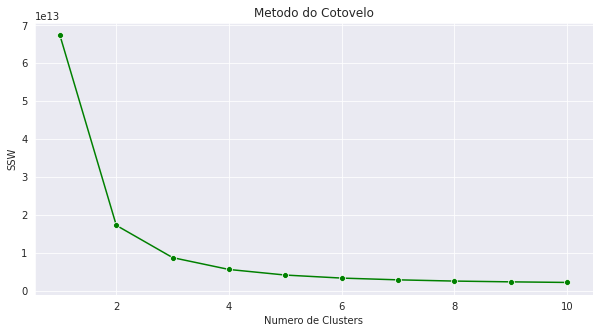

In [ ]:
# Utilizando o metodo do cotovelo para otimizar com o correto numero de clusters
from sklearn.cluster import KMeans

wcss = []

# for
for i in range(1, 11):
    
    
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(data_k)
    
    #  Soma das diferenças ao quadrado com relação ao centro do cluster
    wcss.append(kmeans.inertia_)
    
# plotando grafico
import matplotlib.pyplot as plt

# figure size
plt.figure(figsize=(10,5))
sns.lineplot(range(1, 11), wcss,marker='o',color='green')

# labeling
plt.title('Metodo do Cotovelo')
plt.xlabel('Numero de Clusters')
plt.ylabel('SSW')
plt.show()

In [ ]:
# Tentativa com 3 clusters


kmeans = KMeans(n_clusters=3, random_state=0) 

# fitting the values
kmeans.fit(data_k)

# Cluster centers
kmeans.cluster_centers_

# printing the value of inertia
print (kmeans.inertia_)

8779883394159.252


In [ ]:

labels = kmeans.labels_

# check how many of the samples were correctly labeled
correct_labels = sum(y == labels)

# resultados
print("Resultado: %d de  %d amostras foram corretamente rotuladas." % (correct_labels, y.size))

Resultado: 162 de  382772 amostras foram corretamente rotuladas.


# Utilizando apriori , nesse caso, será realizada a analize por associação, como se trata de registros de compra onde tem varios produtos por cliente, tentaremos determinar as associações ao escolher um determinado produto.

In [ ]:
df.head()

,Pedido,Produto,Quantidade,Data,Preco,Id_Cliente,Pais
0,536365,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.00,United Kingdom
1,536365,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom
2,536365,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.00,United Kingdom
3,536365,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom
4,536365,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom


In [ ]:
# Criando uma matriz que correlaciona os produtos e suas quantidades com o pedido
df_matriz = df.groupby(['Pedido', 'Produto']).  \
    agg({"Quantidade": "sum"}).unstack().fillna(0).  \
    applymap(lambda x: 1 if x > 0 else 0)

df_matriz.head(10)

Quantidade                             \
Produto 10 COLOUR SPACEBOY PEN 12 COLOURED PARTY BALLOONS   
Pedido                                                      
536365                       0                          0   
536366                       0                          0   
536367                       0                          0   
536368                       0                          0   
536369                       0                          0   
536370                       0                          0   
536371                       0                          0   
536372                       0                          0   
536373                       0                          0   
536374                       0                          0   

                                                             \
Produto 12 DAISY PEGS IN WOOD BOX 12 EGG HOUSE PAINTED WOOD   
Pedido                                                        
536365                          0                         0   
536366                          0                         0   
536367                          0                         0   
536368                          0                         0   
536369                          0                         0   
536370                          0                         0   
536371                          0                         0   
536372                          0                         0   
536373                          0                         0   
536374                          0                         0   

                                                                       \
Produto 12 HANGING EGGS HAND PAINTED 12 IVORY ROSE PEG PLACE SETTINGS   
Pedido                                                                  
536365                             0                                0   
536366                             0                                0   
536367                             0                                0   
536368                             0                                0   
536369                             0                                0   
536370                             0                                0   
536371                             0                                0   
536372                             0                                0   
536373                             0                                0   
536374                             0                                0   

                                                                       \
Produto 12 MESSAGE CARDS WITH ENVELOPES 12 PENCIL SMALL TUBE WOODLAND   
Pedido                                                                  
536365                                0                             0   
536366                                0                             0   
536367                                0                             0   
536368                                0                             0   
536369                                0                             0   
536370                                0                             0   
536371                                0                             0   
536372                                0                             0   
536373                                0                             0   
536374                                0                             0   

                                                                         \
Produto 12 PENCILS SMALL TUBE RED RETROSPOT 12 PENCILS SMALL TUBE SKULL   
Pedido                                                                    
536365                                    0                           0   
536366                                    0                           0   
536367                                    0                           0   
536368                                    0             

In [ ]:
#Regras de associação
produtos_frequentes = apriori(df_matriz, min_support=0.01, use_colnames=True)  # o ideal era utilizar o minimo support possivel, mas devodo a quantidade de linhas poderá levar muito tempo para realizar o processo
produtos_frequentes.sort_values("support", ascending=False)

,support,itemsets
586,0.11,"((Quantidade, WHITE HANGING HEART T-LIGHT HOLD..."
411,0.09,"((Quantidade, REGENCY CAKESTAND 3 TIER))"
244,0.09,"((Quantidade, JUMBO BAG RED RETROSPOT))"
35,0.07,"((Quantidade, ASSORTED COLOUR BIRD ORNAMENT))"
334,0.07,"((Quantidade, PARTY BUNTING))"
278,0.07,"((Quantidade, LUNCH BAG RED RETROSPOT))"
465,0.06,"((Quantidade, SET OF 3 CAKE TINS PANTRY DESIGN))"
370,0.06,"((Quantidade, POSTAGE))"
270,0.06,"((Quantidade, LUNCH BAG BLACK SKULL.))"
320,0.05,"((Quantidade, PACK OF 72 RETROSPOT CAKE CASES))"


In [ ]:
# Verificando as regras , antecedentes, consequentes, suports, confianca , convicção, etc.
regras = association_rules(produtos_frequentes, metric="support", min_threshold=0.01) 
regras.sort_values("support", ascending=False).head(10)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
217,"((Quantidade, JUMBO BAG RED RETROSPOT))","((Quantidade, JUMBO BAG PINK POLKADOT))",0.09,0.05,0.03,0.34,7.22,0.03,1.45
216,"((Quantidade, JUMBO BAG PINK POLKADOT))","((Quantidade, JUMBO BAG RED RETROSPOT))",0.05,0.09,0.03,0.62,7.22,0.03,2.44
24,"((Quantidade, ALARM CLOCK BAKELIKE GREEN))","((Quantidade, ALARM CLOCK BAKELIKE RED))",0.04,0.05,0.03,0.67,14.25,0.03,2.90
25,"((Quantidade, ALARM CLOCK BAKELIKE RED))","((Quantidade, ALARM CLOCK BAKELIKE GREEN))",0.05,0.04,0.03,0.61,14.25,0.03,2.47
408,"((Quantidade, LUNCH BAG RED RETROSPOT))","((Quantidade, LUNCH BAG PINK POLKADOT))",0.07,0.05,0.03,0.40,8.00,0.02,1.59
409,"((Quantidade, LUNCH BAG PINK POLKADOT))","((Quantidade, LUNCH BAG RED RETROSPOT))",0.05,0.07,0.03,0.56,8.00,0.02,2.10
330,"((Quantidade, LUNCH BAG BLACK SKULL.))","((Quantidade, LUNCH BAG RED RETROSPOT))",0.06,0.07,0.03,0.49,7.01,0.02,1.82
331,"((Quantidade, LUNCH BAG RED RETROSPOT))","((Quantidade, LUNCH BAG BLACK SKULL.))",0.07,0.06,0.03,0.40,7.01,0.02,1.57
116,"((Quantidade, ROSES REGENCY TEACUP AND SAUCER))","((Quantidade, GREEN REGENCY TEACUP AND SAUCER))",0.04,0.04,0.03,0.69,19.17,0.03,3.10
117,"((Quantidade, GREEN REGENCY TEACUP AND SAUCER))","((Quantidade, ROSES REGENCY TEACUP AND SAUCER))",0.04,0.04,0.03,0.77,19.17,0.03,4.26


In [ ]:
# 10 registros com maiores subidas, e bons valores de confidence e conviction
regras_ordenadas = regras.sort_values("lift", ascending=False)
regras.sort_values("lift", ascending=False).head(10)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
528,"((Quantidade, REGENCY SUGAR BOWL GREEN))","((Quantidade, REGENCY MILK JUG PINK))",0.01,0.01,0.01,0.76,56.59,0.01,4.17
529,"((Quantidade, REGENCY MILK JUG PINK))","((Quantidade, REGENCY SUGAR BOWL GREEN))",0.01,0.01,0.01,0.75,56.59,0.01,3.96
530,"((Quantidade, REGENCY TEA PLATE ROSES))","((Quantidade, REGENCY TEA PLATE GREEN))",0.02,0.01,0.01,0.69,50.76,0.01,3.16
531,"((Quantidade, REGENCY TEA PLATE GREEN))","((Quantidade, REGENCY TEA PLATE ROSES))",0.01,0.02,0.01,0.84,50.76,0.01,6.20
505,"((Quantidade, POPPY'S PLAYHOUSE LIVINGROOM))","((Quantidade, POPPY'S PLAYHOUSE BEDROOM))",0.01,0.02,0.01,0.81,48.00,0.01,5.21
504,"((Quantidade, POPPY'S PLAYHOUSE BEDROOM))","((Quantidade, POPPY'S PLAYHOUSE LIVINGROOM))",0.02,0.01,0.01,0.64,48.00,0.01,2.78
561,"((Quantidade, SET/6 RED SPOTTY PAPER PLATES))","((Quantidade, SET/6 RED SPOTTY PAPER CUPS))",0.02,0.02,0.01,0.72,47.34,0.01,3.58
560,"((Quantidade, SET/6 RED SPOTTY PAPER CUPS))","((Quantidade, SET/6 RED SPOTTY PAPER PLATES))",0.02,0.02,0.01,0.82,47.34,0.01,5.57
506,"((Quantidade, POPPY'S PLAYHOUSE KITCHEN))","((Quantidade, POPPY'S PLAYHOUSE LIVINGROOM))",0.02,0.01,0.01,0.62,46.07,0.01,2.59
507,"((Quantidade, POPPY'S PLAYHOUSE LIVINGROOM))","((Quantidade, POPPY'S PLAYHOUSE KITCHEN))",0.01,0.02,0.01,0.85,46.07,0.01,6.65


In [ ]:
# Testes para fazer e obter recomendacoes

# ('Quantity', 'REGENCY SUGAR BOWL GREEN')
# ('Quantity', 'REGENCY MILK JUG PINK')
# ('Quantity', 'REGENCY TEA PLATE ROSES')
# ('Quantity', 'REGENCY TEA PLATE GREEN')

recomencacoes = []

for i, produto in regras_ordenadas["antecedents"].items():
    for j in list(produto):
        if j == ('Quantidade', 'REGENCY MILK JUG PINK'):
            recomencacoes.append(list(regras_ordenadas.iloc[i]["consequents"]))

In [ ]:
recomencacoes

[[('Quantidade', 'LUNCH BAG RED RETROSPOT'),
  ('Quantidade', 'JUMBO BAG RED RETROSPOT')]]

# Acredito que seria uma análise interessante , dentre esses 10 itens , a maioria tem um valor de confiança alto > 70% e um bom valor de lift. Seria um bom argumento para trabalhar com promoções/ indicações de conjuntos de produtos para aumentar vendas e indicar itens associados para adicionar ao carrinho de compras, etc.